### **1. Import the Required Libraries**

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')

In [4]:
import tensorflow as tf
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras.layers import Dense,Flatten,Conv2D,MaxPooling2D
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers  import Concatenate
from tensorflow.keras.layers import AveragePooling2D, Dropout, Input, BatchNormalization
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix
from PIL import Image
from tqdm import tqdm
import urllib
from tensorflow.keras.preprocessing import image
from sklearn.metrics import precision_recall_curve,roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
import os
from sklearn.metrics import log_loss, brier_score_loss
from sklearn.metrics import cohen_kappa_score
import matplotlib.cm as cm
from sklearn.metrics import matthews_corrcoef
import pandas as pd
import seaborn as sns
import numpy as np
import cv2
from sklearn.preprocessing import label_binarize
from sklearn.metrics import average_precision_score
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Activation, BatchNormalization, Conv2D, Dense, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

%matplotlib inline

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# **Read Data**

In [5]:
image_path="/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/"

In [6]:
train_image_path = '/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train/'
valid_image_path = '/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid/'

test_image_path="./kaggle/input/new-plant-diseases-dataset/test/test/"

# **Data Analysis**

**class name**

In [7]:
class_names = os.listdir(image_path)
print(class_names)

['Tomato___Late_blight', 'Tomato___healthy', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Potato___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Tomato___Early_blight', 'Tomato___Septoria_leaf_spot', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Strawberry___Leaf_scorch', 'Peach___healthy', 'Apple___Apple_scab', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Bacterial_spot', 'Apple___Black_rot', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Peach___Bacterial_spot', 'Apple___Cedar_apple_rust', 'Tomato___Target_Spot', 'Pepper,_bell___healthy', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Potato___Late_blight', 'Tomato___Tomato_mosaic_virus', 'Strawberry___healthy', 'Apple___healthy', 'Grape___Black_rot', 'Potato___Early_blight', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Common_rust_', 'Grape___Esca_(Black_Measles)', 'Raspberry___healthy', 'Tomato___Leaf_Mold', 'Tomato__

In [8]:
from PIL import Image

def create_data_frame(path):
    list_plant=[]
    list_category=[]
    list_disease=[]
    list_path=[]
    list_plant_category=[]
    list_image_size=[]
    list_image_type=[]
    list_size=[]
    
    for path,directory,files in os.walk(path,topdown=False):
        for name in files:
            plant_category=category=path.split("/")[-1]
            plant=plant_category.split("___")[0]
            category=plant_category.split("___")[-1]
            disease=0 if category=="healthy" else 1
            full_path=path+"/"+name
            image_type=name.split(".")[1]
            size=os.path.getsize(full_path)
            with Image.open(full_path) as images:
                width,height=images.size
            list_plant.append(plant)
            list_category.append(category)
            list_disease.append(disease)
            list_path.append(full_path)
            list_plant_category.append(plant_category)
            list_image_size.append(str(width)+"x"+str(height))
            list_image_type.append(image_type)
            list_size.append(size)
    
        
                            

    data_info=pd.DataFrame.from_dict({"Plant":list_plant,"Category":list_category,"Disease":list_disease,
                           "Path":list_path,"Plant_Category":list_plant_category,"Image_size":list_image_size,"Image_type":list_image_type,"Size":list_size},orient="columns")

    image_count_info=pd.DataFrame(data_info.groupby(["Plant","Category","Plant_Category"]).size())
    image_count_info.rename(columns={0:"nb"},inplace=True)
    image_count_info=image_count_info.reset_index()
    return data_info,image_count_info

train_data_info,train_data_count=create_data_frame(train_image_path)
valid_data_info,valid_data_count=create_data_frame(valid_image_path)

# **Image Information Train vs Valid**

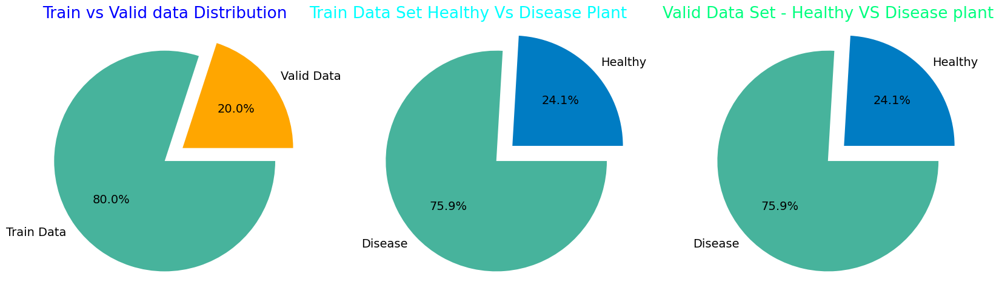

In [9]:
def image_information(data_set_info):
    plt.rcParams["font.size"]=14
    plt.pie([data_set_info.nb[data_set_info.Category=="healthy"].sum(),data_set_info.nb[data_set_info.Category!="health"].sum()],labels=["Healthy","Disease"],autopct=lambda x:str(round(x,1))+"%",colors=["#007CC3","#47B39C"],shadow=False,explode=(0.20,0))

    
plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.title("Train vs Valid data Distribution",fontsize=19,color="Blue")
plt.rcParams["font.size"]=14

# image_information(valid_data_count)
plt.pie([valid_data_count.nb.sum(),train_data_count.nb.sum()],labels=["Valid Data","Train Data"],autopct=lambda x: str(round(x,2))+"%",colors=["#FFA600","#47B39C"],shadow=False,explode=(0.20,0))
plt.subplot(1,3,2)
plt.title("Train Data Set Healthy Vs Disease Plant "        "          "  ,fontsize=19,color="aqua")
image_information(train_data_count)
plt.subplot(1,3,3)
plt.title('Valid Data Set - Healthy VS Disease plant', fontsize=19,color="springgreen")
image_information(valid_data_count)

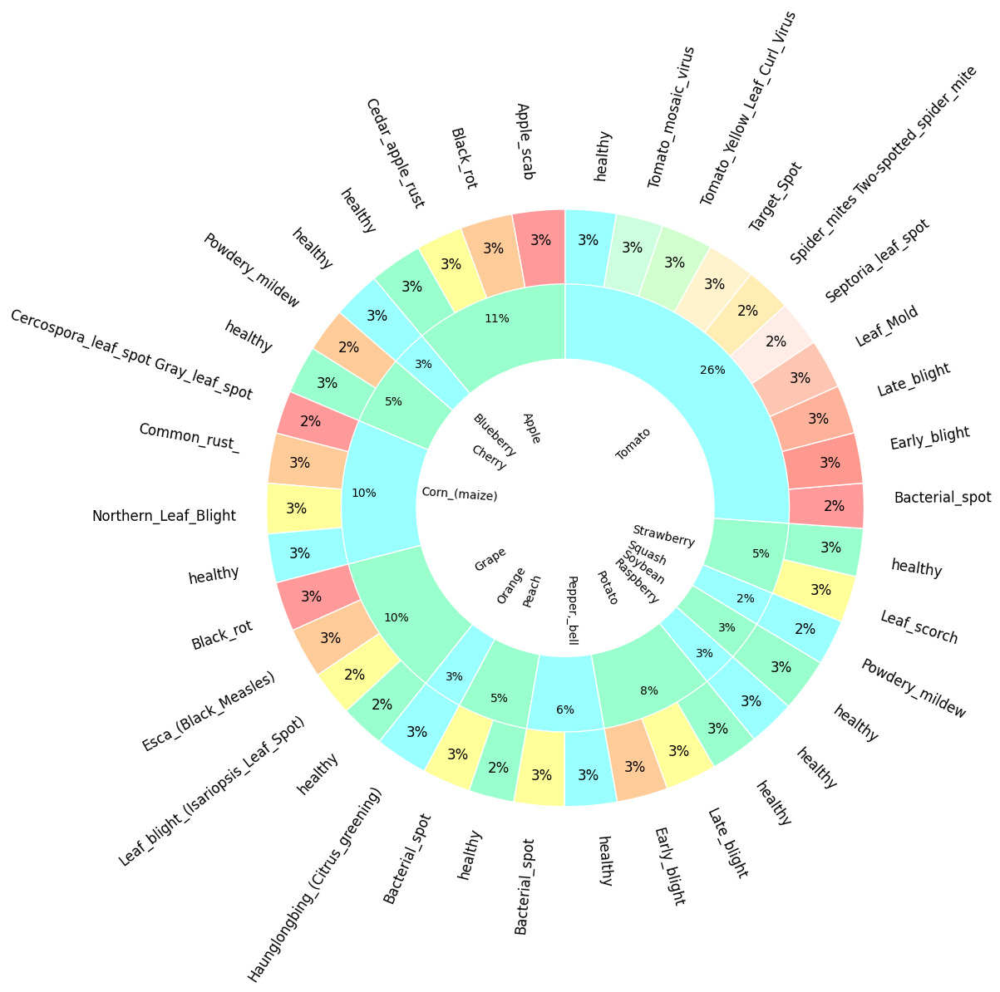

In [10]:
def  class_data_distribution(class_data_count,class_data_info):
    list_plant_mod= ['Cherry' if x == 'Cherry_(including_sour)' else x for x in list(class_data_count.Plant.unique())]


    pi_chart_color_0 = ['#99ffcc', '#99ffff', '#99ffcc', '#99ffff','#99ffcc', '#99ffff','#99ffcc', '#99ffff','#99ffcc', '#99ffff','#99ffcc', '#99ffff','#99ffcc', '#99ffff',]
    pi_chart_color_1 = ['#ff999a','#ffcb99', '#fffe99','#99ffcc',
                                                                                                                 '#99ffff',
                                                                                                                 '#ffcb99', '#99ffcc',
                                                                                                                 '#ff999a','#ffcb99','#fffe99','#99ffff',
                                                                                                                 '#ff999a','#ffcb99','#fffe99','#99ffcc',
                                                                                                                 '#99ffff',
                                                                                                                 '#fffe99','#99ffcc',
                                                                                                                 '#fffe99','#99ffff',
                                                                                                                 '#ffcb99','#fffe99','#99ffcc',
                                                                                                                 '#99ffff',
                                                                                                                 '#99ffcc',
                                                                                                                 '#99ffff',
                                                                                                                 '#fffe99','#99ffcc',
                                                                                                                 '#ff999a','#ff9990','#ffb299','#ffc5b3','#ffece6','#ffedb3','#fff3cd','#d1ffcd','#cdffdf','#99ffff']
 

    plt.pie(class_data_count.nb, labels=class_data_count.Category,  startangle=90,frame=True,radius=1,rotatelabels=True,colors=pi_chart_color_1,wedgeprops=dict(width=0.9, edgecolor='w'),autopct='%1.f%%',pctdistance=0.90, textprops={'fontsize': 12})
    plt.pie(class_data_info.groupby(['Plant']).size(),labels=list_plant_mod,radius=0.75,startangle=90,labeldistance=0.3,rotatelabels=True,colors=pi_chart_color_0,wedgeprops=dict(width=0.9, edgecolor='w'),autopct='%1.f%%',pctdistance=0.90, textprops={'fontsize': 10})
    centre_circle = plt.Circle((0,0),0.5,color='black', fc='white',linewidth=0)
    fig = plt.gcf()
    fig.gca().add_artist(centre_circle)
 
    plt.axis('equal')
    plt.tight_layout()
    plt.show()

plt.figure(figsize=(12,12))
class_data_distribution(train_data_count,train_data_info)

# **Visualize Images**

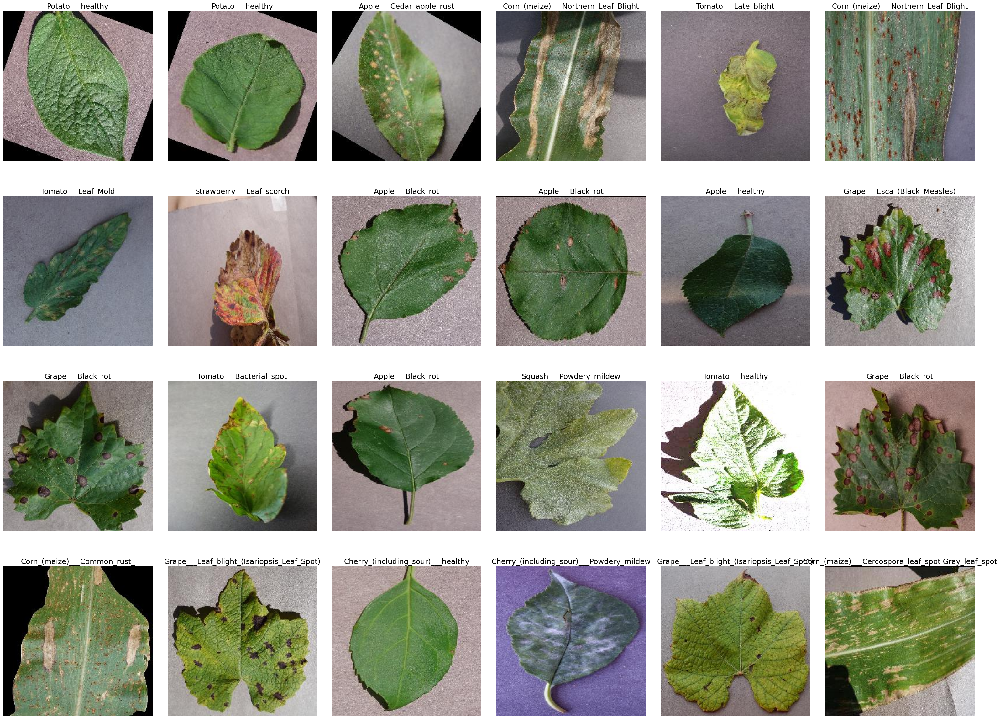

In [11]:
plt.figure(figsize=(40,30))
plt.subplots_adjust(wspace=0.1, hspace=0.1)

for i in range(24):
    random_folder = np.random.randint(0, len(os.listdir(image_path)))
    random_folder_path = os.path.join(image_path, os.listdir(image_path)[random_folder])
    random_image = np.random.randint(0, len(os.listdir(random_folder_path)))
    random_image_path = os.path.join(random_folder_path, os.listdir(random_folder_path)[random_image])
    image = cv2.imread(random_image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # Get the class name for the current image
    class_name = class_names[random_folder]
    
    plt.subplot(4, 6, i + 1)
    plt.imshow(image)
    plt.axis("off")
    plt.title(class_name)  

plt.show()

In [12]:
print("Number of classes : {}".format(len(class_names)))

Number of classes : 38


# **Number of images in each class**

In [13]:
numberof_images={}
for class_name in class_names:
    numberof_images[class_name]=len(os.listdir(image_path+"/"+class_name))
images_each_class=pd.DataFrame(numberof_images.values(),index=numberof_images.keys(),columns=["Number of images"])
images_each_class

,Number of images
Tomato___Late_blight,1851
Tomato___healthy,1926
Grape___healthy,1692
Orange___Haunglongbing_(Citrus_greening),2010
Soybean___healthy,2022
Squash___Powdery_mildew,1736
Potato___healthy,1824
Corn_(maize)___Northern_Leaf_Blight,1908
Tomato___Early_blight,1920
Tomato___Septoria_leaf_spot,1745


In [14]:
IMG_WIDTH = 100
IMG_HEIGHT = 100
batch_size=32

# **Train_data,Valid_data and Test_data Generator**

In [15]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rescale=1.0/255,
                                  zoom_range=0.2,
                                  width_shift_range=0.2,
                                  height_shift_range=0.2,
                                  fill_mode='nearest')
train_generator = train_datagen.flow_from_directory(train_image_path,
                                                   target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                   batch_size=batch_size,
                                                   class_mode='categorical',
                                                   shuffle=True)

Found 70295 images belonging to 38 classes.


In [16]:
testdata_generator=tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

test_data_generator=testdata_generator.flow_from_directory(valid_image_path,batch_size=batch_size,class_mode="categorical",
                                                           target_size=(IMG_WIDTH,IMG_HEIGHT),color_mode="rgb",shuffle=False )

Found 17572 images belonging to 38 classes.


In [17]:
validation_datagen = ImageDataGenerator(rescale=1.0/255)
validation_generator = validation_datagen.flow_from_directory(valid_image_path,
                                                             target_size=(IMG_WIDTH, IMG_HEIGHT),
                                                             batch_size=batch_size,
                                                             class_mode='categorical',
                                                             shuffle=True)

Found 17572 images belonging to 38 classes.


In [18]:
train_number=train_generator.samples
valid_number=validation_generator.samples

### **Training a CNN Model**

Since the training dataset is ready let's create a simple CNN Model to train on the image datasets

#### **Create a CNN Model**

In [19]:
def create_model():
    model = Sequential([
        Conv2D(filters=128, kernel_size=(5, 5), padding='valid', input_shape=(IMG_WIDTH, IMG_HEIGHT, 3)),
        Activation('relu'),
        MaxPooling2D(pool_size=(2, 2)),
        BatchNormalization(),

        Conv2D(filters=64, kernel_size=(3, 3), padding='valid', kernel_regularizer=l2(0.00005)),
        Activation('relu'),
        MaxPooling2D(pool_size=(2, 2)),
        BatchNormalization(),

        Conv2D(filters=32, kernel_size=(3, 3), padding='valid', kernel_regularizer=l2(0.00005)),
        Activation('relu'),
        MaxPooling2D(pool_size=(2, 2)),
        BatchNormalization(),

        Flatten(),

        Dense(units=256, activation='relu'),
        Dropout(0.5),
        Dense(units=128, activation='relu'),
        Dropout(0.5),
        Dense(units=38, activation='sigmoid')
    ])

    return model

In [20]:
cnn_model = create_model()

In [21]:
print(cnn_model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 96, 96, 128)       9728      
                                                                 
 activation (Activation)     (None, 96, 96, 128)       0         
                                                                 
 max_pooling2d (MaxPooling2  (None, 48, 48, 128)       0         
 D)                                                              
                                                                 
 batch_normalization (Batch  (None, 48, 48, 128)       512       
 Normalization)                                                  
                                                                 
 conv2d_1 (Conv2D)           (None, 46, 46, 64)        73792     
                                                                 
 activation_1 (Activation)   (None, 46, 46, 64)        0

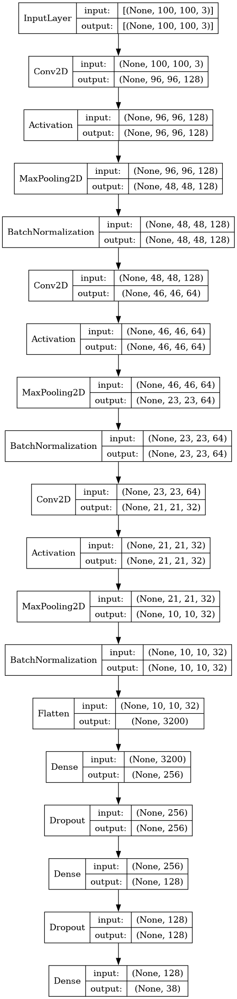

In [22]:
from tensorflow.keras.utils import plot_model
plot_model(cnn_model, expand_nested=True, show_shapes=True, show_layer_names=False)

#### **Defining Callbacks**

A callback is an object that can perform actions at various stages of training (e.g. at the start or end of an epoch, before or after a single batch, etc)

#### **a. Reduce Learning Rate on Plateau**

Is used to reduce the learning rate when a metric has stopped improving.

In [23]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=np.sqrt(0.1), patience=5)

#### **Defining the Optimizer**

In [24]:
optimizer = Adam(learning_rate=0.0001)

#### **Compile the Model**

In [27]:
cnn_model.compile(optimizer=optimizer, loss=['categorical_crossentropy', 'categorical_crossentropy', 'categorical_crossentropy'],loss_weights=[1, 0.3, 0.3], metrics=['accuracy'])

#### **Training the Model**

In [28]:
history = cnn_model.fit(train_generator,
                        validation_data=validation_generator,
                        steps_per_epoch=train_number // batch_size,
                        epochs=30, 
                        validation_steps=valid_number // batch_size,
                       verbose=2,
                       callbacks=[reduce_lr])

Epoch 1/30
2196/2196 - 278s - loss: 2.0196 - accuracy: 0.4271 - val_loss: 1.4522 - val_accuracy: 0.5672 - lr: 1.0000e-04 - 278s/epoch - 126ms/step
Epoch 2/30
2196/2196 - 300s - loss: 1.6499 - accuracy: 0.5217 - val_loss: 1.4873 - val_accuracy: 0.5677 - lr: 1.0000e-04 - 300s/epoch - 137ms/step
Epoch 3/30
2196/2196 - 307s - loss: 1.3703 - accuracy: 0.5975 - val_loss: 1.3503 - val_accuracy: 0.6052 - lr: 1.0000e-04 - 307s/epoch - 140ms/step
Epoch 4/30
2196/2196 - 290s - loss: 1.1866 - accuracy: 0.6536 - val_loss: 1.7006 - val_accuracy: 0.5786 - lr: 1.0000e-04 - 290s/epoch - 132ms/step
Epoch 5/30
2196/2196 - 294s - loss: 1.0328 - accuracy: 0.6941 - val_loss: 1.2907 - val_accuracy: 0.6314 - lr: 1.0000e-04 - 294s/epoch - 134ms/step
Epoch 6/30
2196/2196 - 307s - loss: 0.9356 - accuracy: 0.7247 - val_loss: 0.9218 - val_accuracy: 0.7173 - lr: 1.0000e-04 - 307s/epoch - 140ms/step
Epoch 7/30
2196/2196 - 340s - loss: 0.8558 - accuracy: 0.7473 - val_loss: 0.9946 - val_accuracy: 0.7200 - lr: 1.0000e-

### **Plotting the Model Metrics**

#### **i. Plotting training and validation accuracy, loss and learning rate**

In [29]:
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

train_loss = history.history['loss']
val_loss = history.history['val_loss']

learning_rate = history.history['lr']

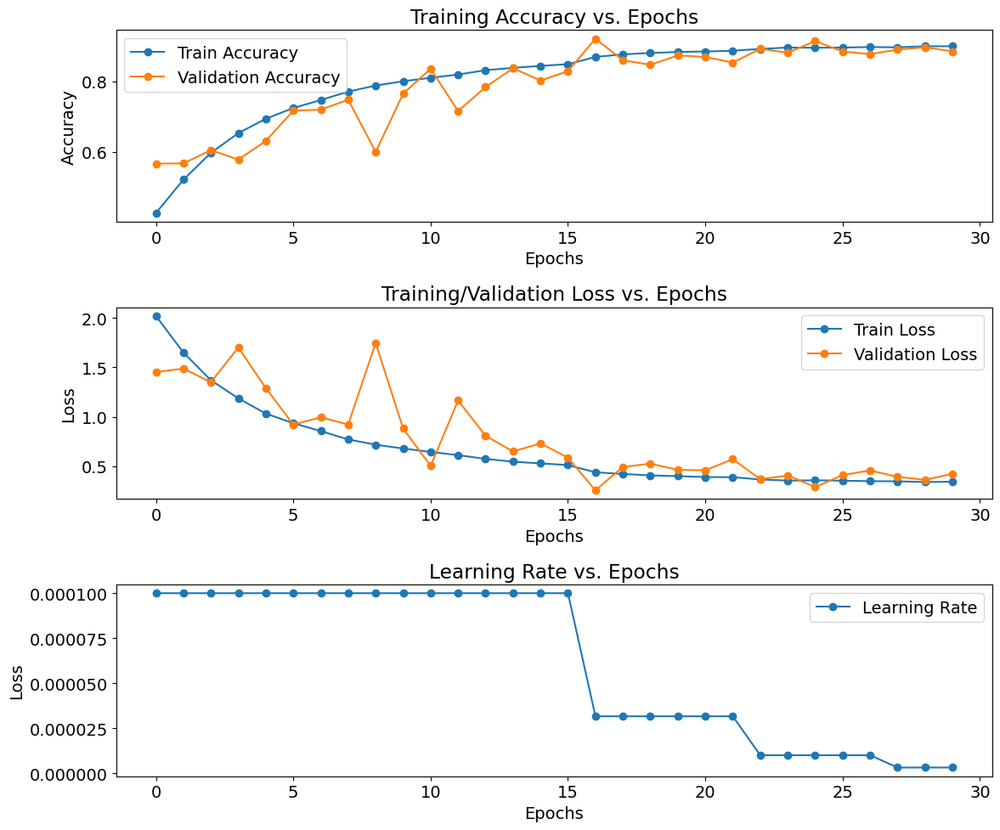

In [30]:
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(12, 10))

ax[0].set_title('Training Accuracy vs. Epochs')
ax[0].plot(train_accuracy, 'o-', label='Train Accuracy')
ax[0].plot(val_accuracy, 'o-', label='Validation Accuracy')
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('Accuracy')
ax[0].legend(loc='best')

ax[1].set_title('Training/Validation Loss vs. Epochs')
ax[1].plot(train_loss, 'o-', label='Train Loss')
ax[1].plot(val_loss, 'o-', label='Validation Loss')
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Loss')
ax[1].legend(loc='best')

ax[2].set_title('Learning Rate vs. Epochs')
ax[2].plot(learning_rate, 'o-', label='Learning Rate')
ax[2].set_xlabel('Epochs')
ax[2].set_ylabel('Loss')
ax[2].legend(loc='best')

plt.tight_layout()
plt.show()

# **Save Model**

In [31]:
cnn_model.save("model.h5")
from tensorflow.keras.models import load_model

cnn_model = load_model("model.h5")

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### **Model Prediction on the Test Dataset**

In [32]:
pred=cnn_model.predict(test_data_generator)
final_predict = np.argmax(pred,axis=1)
true_data=test_data_generator.classes

550/550 [==============================] - 27s 48ms/step


# **Accuracy Score**

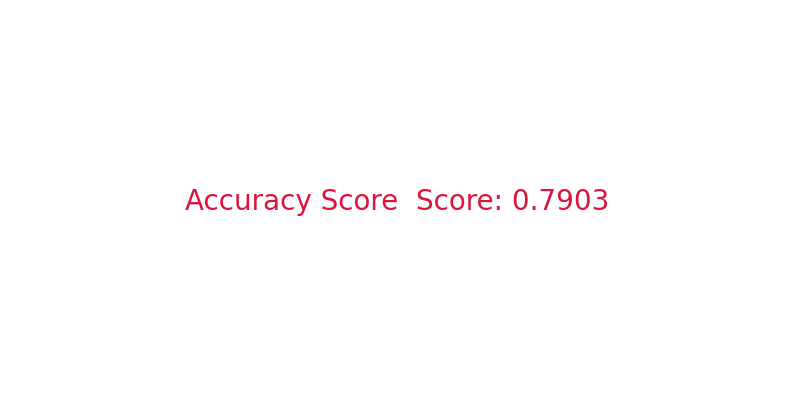

In [33]:
plt.figure(figsize=(10,5),facecolor="white")
acc_score = accuracy_score(true_data,final_predict)
plt.plot([])
plt.text(0,0, f'Accuracy Score  Score: {acc_score:.4f}', fontsize=20, ha='center', va='center',color="crimson")
plt.axis('off')

# Set the x-axis limits
plt.xlim(-1, 1)
plt.ylim(-1,1)

plt.show()

# ROC AUC Score

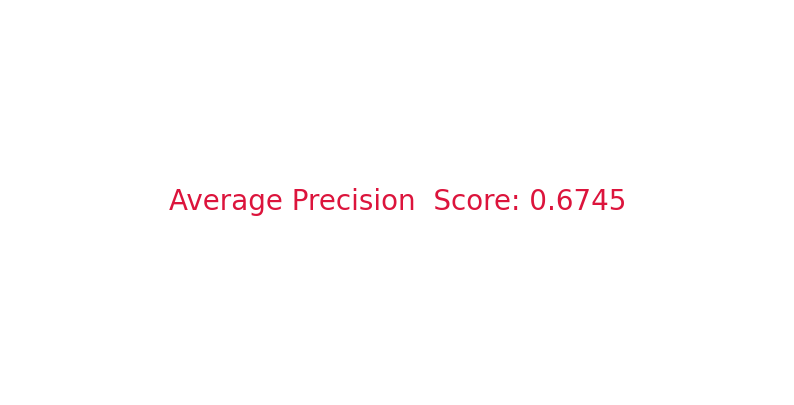

In [34]:
plt.figure(figsize=(10,5),facecolor="white")
# Convert true labels to multilabel-indicator format
num_classes = 38  # Number of classes
true_data_multilabel = label_binarize(true_data, classes=np.arange(num_classes))

# Reshape predicted labels to match the shape of the true labels
final_predict_reshaped = label_binarize(final_predict, classes=np.arange(num_classes))
average_precision = average_precision_score(true_data_multilabel, final_predict_reshaped)

plt.plot([])
plt.text(0,0, f'Average Precision  Score: {average_precision:.4f}', fontsize=20, ha='center', va='center',color="crimson")
plt.axis('off')
plt.xlim(-1, 1)
plt.ylim(-1,1)

plt.show()

# **Plot Precision-Recall curve|**

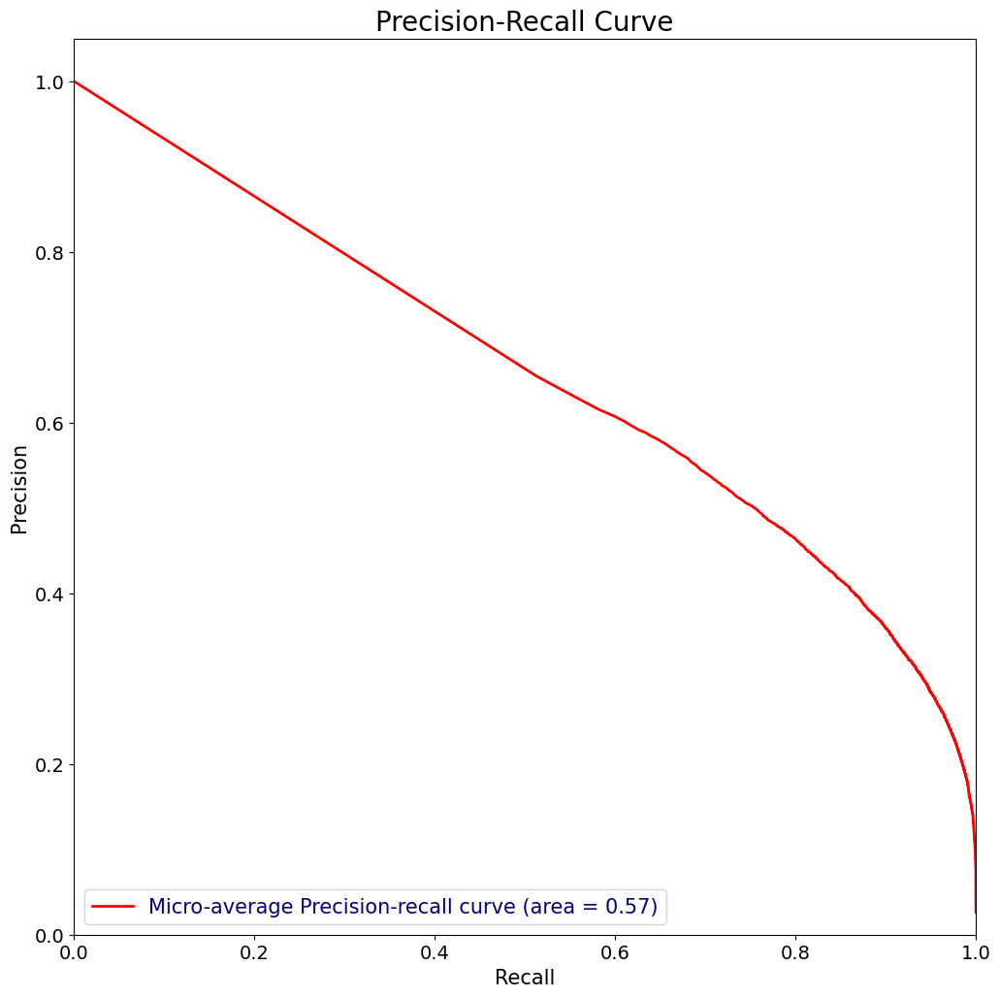

In [35]:
binarize_label = label_binarize(true_data, classes=range(num_classes))
my_class = binarize_label.shape[1]
# Compute Precision-Recall and plot curve
precision = dict()
recall = dict()
average_precision = dict()

for i in range(my_class):
    precision[i],recall[i], _ = precision_recall_curve(binarize_label[:,i],pred[:,i])
    average_precision[i]=average_precision_score(binarize_label[:,i],pred[:,i])
    
precision["micro"],recall["micro"], _ =precision_recall_curve(binarize_label.ravel(),pred.ravel())
average_precision["micro"]=average_precision_score(binarize_label,pred,average="micro")
                                                                  
# Plot Precision-Recall curve
plt.figure(figsize=(12,12))
plt.plot(recall["micro"], precision["micro"], label='Micro-average Precision-recall curve (area = {0:0.2f})'.format(average_precision["micro"]), linewidth=2, color='red')
plt.xlabel('Recall',fontsize=15,color="black")
plt.ylabel('Precision',fontsize=15,color="black")
plt.ylim([0.0, 1.05])
plt.xlim([0.0, 1.0])
plt.title('Precision-Recall Curve',fontsize=20,color="black")
plt.legend(loc="lower left",fontsize=15,labelcolor="navy")
plt.show()

# **Plot Precision-Recall Curve For Each Class**

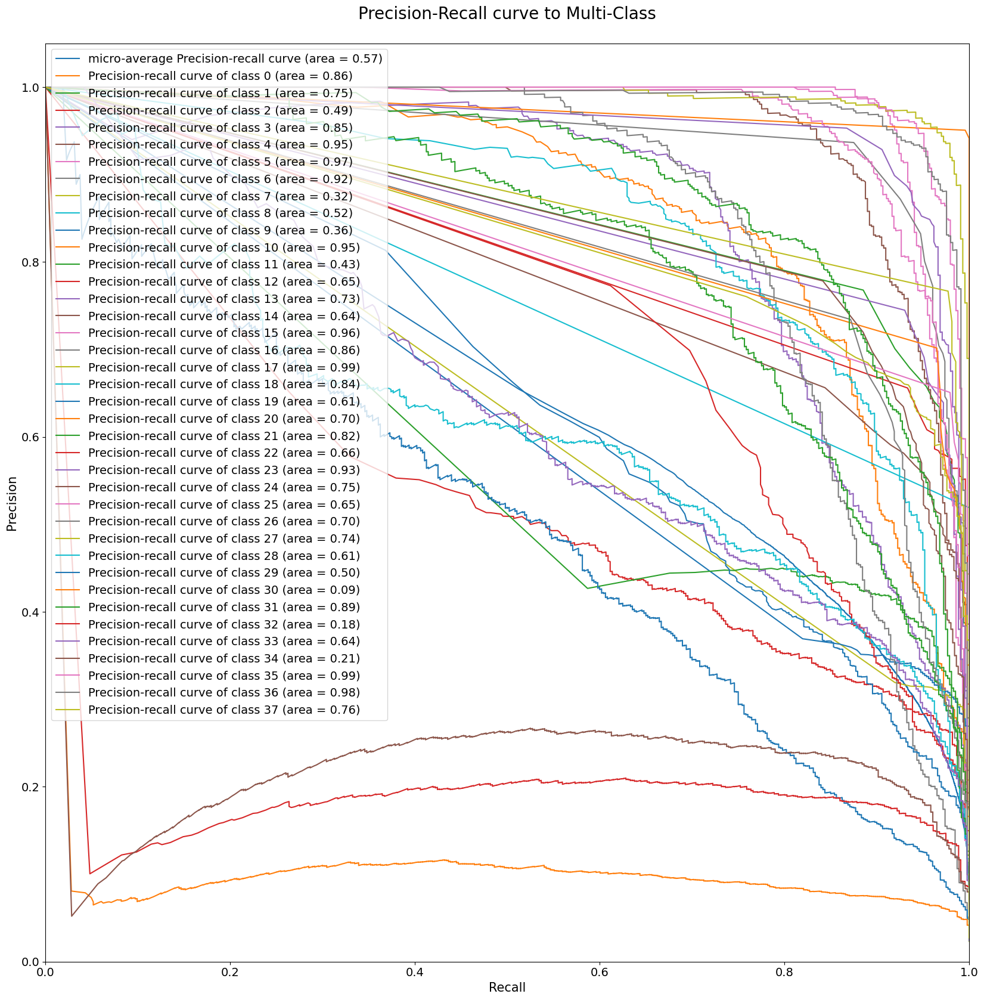

In [36]:
plt.figure(figsize=(20,20))
plt.plot(recall["micro"], precision["micro"],label='micro-average Precision-recall curve (area = {0:0.2f})' ''.format(average_precision["micro"]))
for i in range(my_class):
    plt.plot(recall[i], precision[i],label='Precision-recall curve of class {0} (area = {1:0.2f})' ''.format(i, average_precision[i]))

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Recall',fontsize=15,color="black")
plt.ylabel('Precision',fontsize=15,color="black")
plt.title('Precision-Recall curve to Multi-Class\n',fontsize=20,color="black")
plt.legend(loc="best",labelcolor="black")
plt.show()

# **Receiver operating characteristic curve**

/tmp/ipykernel_42/1182271907.py:13: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = cm.get_cmap('tab20', num_classes)


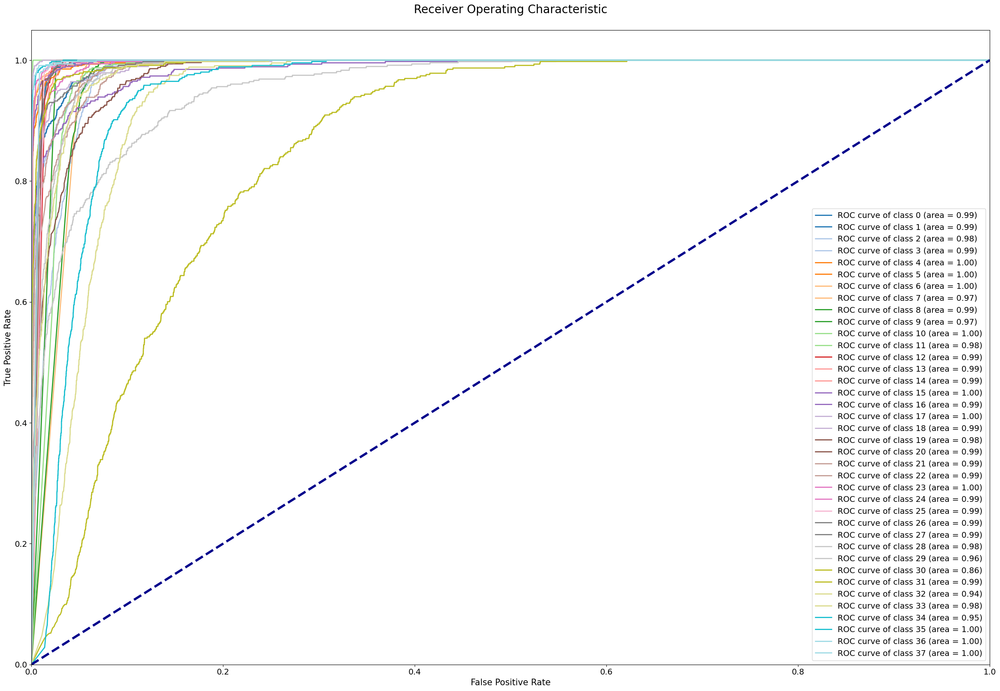

In [37]:
# Compute the ROC curve for each class
num_classes = len(test_data_generator.class_indices)
fpr = dict()
tpr = dict()
roc_auc = dict()

for class_index in range(num_classes):
    fpr[class_index], tpr[class_index], _ = roc_curve((true_data == class_index).astype(int), pred[:, class_index])
    roc_auc[class_index] = auc(fpr[class_index], tpr[class_index])

# Plot the ROC curves
plt.figure(figsize=(30,20))
colors = cm.get_cmap('tab20', num_classes)

for class_index in range(num_classes):
    plt.plot(fpr[class_index], tpr[class_index],color=colors(class_index),lw=2,label='ROC curve of class {0} (area = {1:0.2f})'.format(class_index, roc_auc[class_index]))

plt.plot([0, 1], [0, 1],linestyle="--", lw=4,color="darkblue")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate',fontsize=15,color="black")
plt.ylabel('True Positive Rate',fontsize=15,color="black")
plt.title('Receiver Operating Characteristic\n',fontsize=20,color="black")
plt.legend(loc="lower right")
plt.show()

In [38]:
test_loss, test_accuracy = cnn_model.evaluate(test_data_generator, batch_size=batch_size)

550/550 [==============================] - 26s 46ms/step - loss: 0.4297 - accuracy: 0.8848


In [39]:
print(f"Test Loss:     {test_loss}")
print(f"Test Accuracy: {test_accuracy}")

Test Loss:     0.4297146201133728
Test Accuracy: 0.8847598433494568


The test loss and test accuracy is the same as validation loss and validation accuracy at the last step since the testing and validation datasets are same.

### **Plotting the Classification Metrics**

### **i. Confusion Matrix**

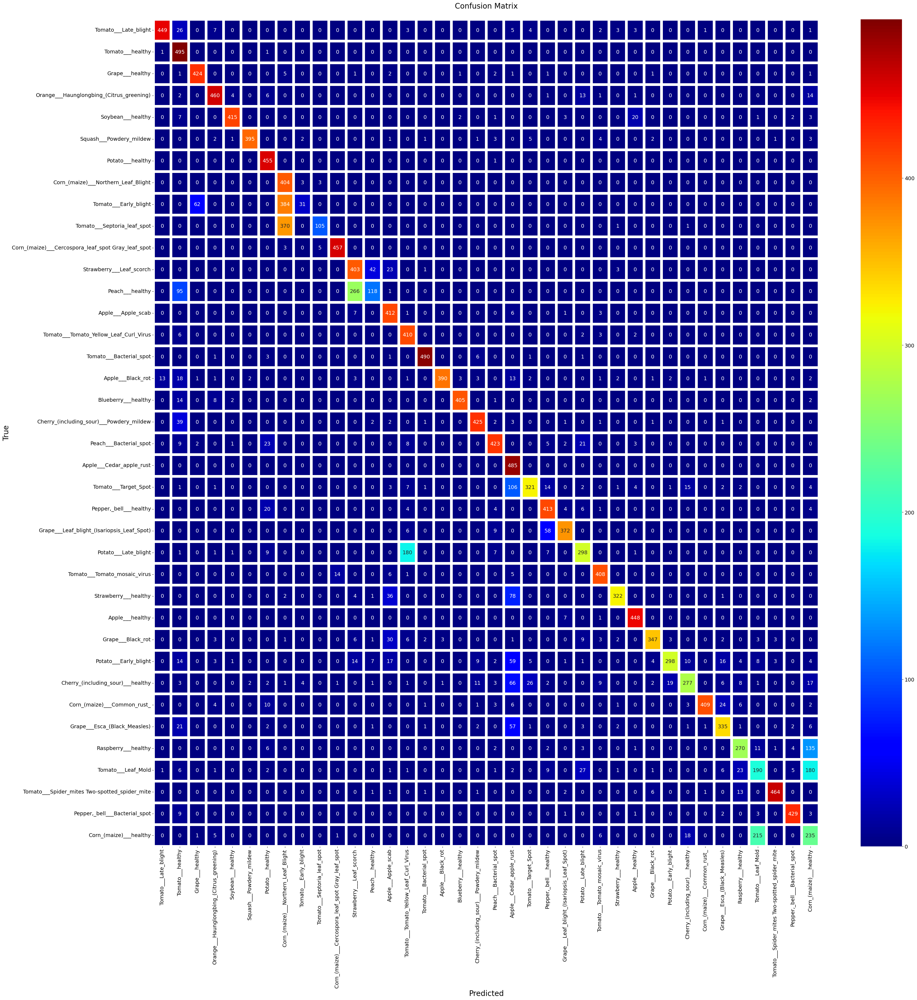

In [40]:
plt.figure(figsize=(40,40))
confusion = confusion_matrix(true_data, final_predict)
sns.heatmap(confusion, annot=True, fmt='d', cmap='jet',xticklabels=class_names,
            yticklabels=class_names,lw=6)
plt.xlabel('Predicted',fontsize=20,color="black")
plt.ylabel('True',fontsize=20,color="black")
plt.title('Confusion Matrix\n',fontsize=20,color="black")
plt.show()

# **Classification Report**

In [41]:
print(classification_report(true_data, final_predict,target_names=class_names))

                                                    precision    recall  f1-score   support

                              Tomato___Late_blight       0.97      0.89      0.93       504
                                  Tomato___healthy       0.65      1.00      0.78       497
                                   Grape___healthy       0.87      0.96      0.91       440
          Orange___Haunglongbing_(Citrus_greening)       0.93      0.92      0.92       502
                                 Soybean___healthy       0.98      0.91      0.94       454
                           Squash___Powdery_mildew       0.99      0.94      0.96       421
                                  Potato___healthy       0.84      1.00      0.91       456
               Corn_(maize)___Northern_Leaf_Blight       0.35      0.99      0.51       410
                             Tomato___Early_blight       0.78      0.06      0.12       477
                       Tomato___Septoria_leaf_spot       0.93      0.22      0.

# **Check Model Prediction**

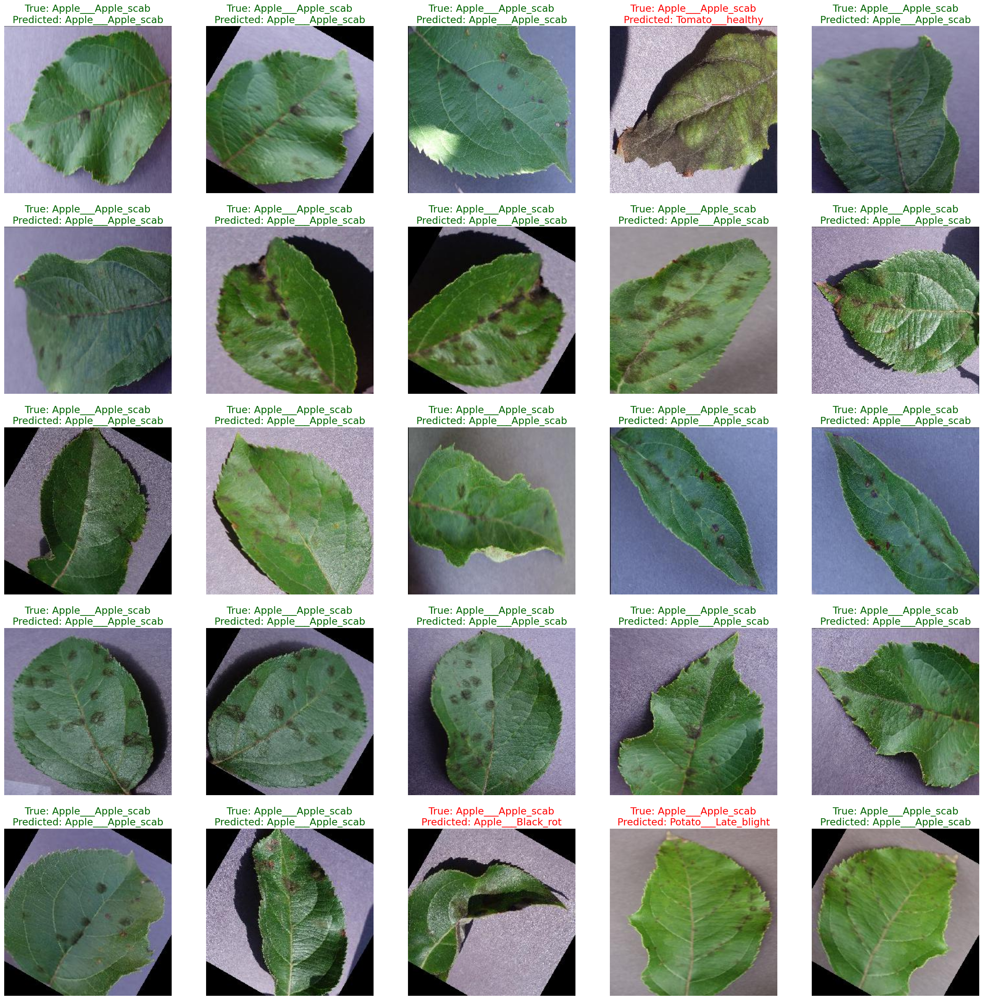

In [48]:
class_name = list(test_data_generator.class_indices.keys())

plt.figure(figsize=(30,30))
number_images=(5,5)
for i in range(1,(number_images[0]*number_images[1])+1):
    plt.subplot(number_images[0],number_images[1],i)
    plt.axis("off")
    
    true_label = class_name[test_data_generator.classes[i]]
    predicted_label = class_name[final_predict[i]]
    
    color="darkgreen"
    if true_label != predicted_label:
        color="red"
    
    plt.title(f"True: {true_label}\nPredicted: {predicted_label}", color=color)
    plt.imshow(plt.imread(test_data_generator.filepaths[i]))
plt.show()

# **Custom Data Prediction**

In [45]:
plt.figure(figsize=(15, 15))

img_url = "https://cdn.britannica.com/89/126689-004-D622CD2F/Potato-leaf-blight.jpg"

filename, headers = urllib.request.urlretrieve(img_url)
img_path = os.path.join(os.getcwd(), filename)
img = Image.open(img_path)
img = img.resize((120, 120))
img = np.array(img) / 255.0
img = np.expand_dims(img, axis=0)
probs = model.predict(img)[0]

# Get the predicted class index and name
pred_class_prob = np.argmax(probs)
pred_class_name = class_names[pred_class_prob]

max_prob = np.max(probs)
print(f'Predicted class: {pred_class_name}')
print(f'Maximum probability: {max_prob}')

# Display the image with the predicted class and probability
plt.imshow(img[0])
plt.axis('off')
plt.text(5, 15, f'Predicted class: {pred_class_name}\nMaximum probability: {max_prob:.2f}', fontsize=20, color='red', bbox=dict(facecolor='white', alpha=0.8))
plt.show()

NameError: name 'model' is not defined

<Figure size 1500x1500 with 0 Axes>

### **Wrong Predictions**

Let's see where the model has given wrong predictions and what were the actual predictions on those images.

In [46]:
errors = (y_true - y_pred != 0)
y_true_errors = y_true[errors]
y_pred_errors = y_pred[errors]

NameError: name 'y_true' is not defined

In [47]:
test_images = test_generator.filenames
test_img = np.asarray(test_images)[errors]

NameError: name 'test_generator' is not defined

NameError: name 'test_img' is not defined

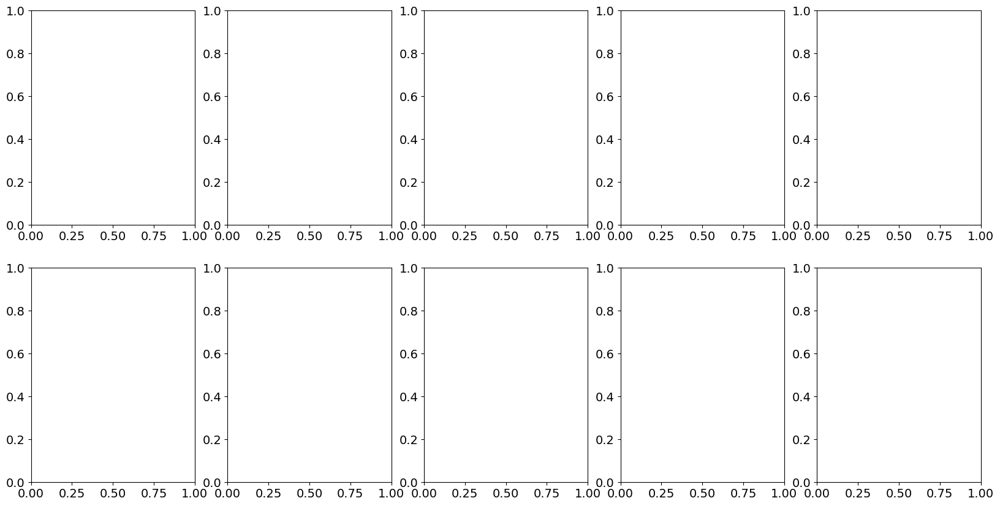

In [49]:
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(20, 10))
idx = 0

for i in range(2):
    for j in range(5):
        idx = np.random.randint(0, len(test_img))
        true_index = y_true_errors[idx]
        true_label = labels[true_index]
        predicted_index = y_pred_errors[idx]
        predicted_label = labels[predicted_index]
        ax[i, j].set_title(f"True Label: {true_label} \n Predicted Label: {predicted_label}")
        img_path = os.path.join(test_dataset, test_img[idx])
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        ax[i, j].imshow(img)
        ax[i, j].axis("off")

plt.tight_layout()
plt.suptitle('Wrong Predictions made on test set', fontsize=20)
plt.show()